# Load

In [1]:
# Multimedia and ML Project - Endoscopy
# Courtesy: Kaggle for Car Detection Dataset & https://github.com/himanshurawlani for Visualizing of Layer Output
# Aishwarya GS, Harshitha Ranjith and Sri Sai Tanvi Sonti, B.Tech CSE (CYS)
# Mentored and Guided by: Ramaguru Radhakrishnan, Assistant Professor, Sr. Gr.
# TIFAC-CORE in Cyber Security, Amrita Vishwa Vidyapeetham, Coimbatore

!pip install keras-flops
!pip install scikit-plot
!pip install opencv-python
!pip install tensorflow

In [3]:
import os
import cv2
import time
import pickle
import logging
import itertools
import scikitplot
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.patheffects as path_effects

from keras_flops import get_flops
from sklearn.utils import class_weight
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input
from tensorflow.keras import applications
from tensorflow.keras import Model, layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import load_model
from keras.utils.layer_utils import count_params
from sklearn.metrics import accuracy_score, mean_squared_error, mean_squared_log_error, classification_report, confusion_matrix, roc_curve, auc

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.layers import AveragePooling2D, AlphaDropout, Activation, Add, BatchNormalization, Concatenate, Layer, ReLU, Conv2D, MaxPooling2D, GlobalAveragePooling2D, Dense, Dropout

# Models
from tensorflow.keras.applications.efficientnet import EfficientNetB0 as trainable_model_a
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2 as trainable_model_b
from tensorflow.keras.applications.resnet_v2 import ResNet50V2 as trainable_model_c

# Prevent error unnecessary messages
tf.get_logger().setLevel(logging.ERROR)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

print("Packages successfully imported!")


Packages successfully imported!


# **Set**

In [4]:
#Set constants 
batch_size = 25
epochs = 5
optimizer = Adam(learning_rate=0.00001)
architecture = 'MFuReCNN_alpha_do'

In [5]:
#Set model identifiers
DCNN_A = 'DCNN_A' #EfficientNetB0
DCNN_B = 'DCNN_B' #MobileNetV2
DCNN_C = 'DCNN_C' #ResNet50V2

# Custom Save Function

In [6]:
def save_h(file, history):
    """
    Save the training history to a file.

    Parameters:
        file (str): The directory path to save the history file.
        history (History): The training history to be saved.

    Returns:
        None
    """
    with open(file + '/' + architecture + '/' + architecture + '.history', 'wb') as file_pi:
        pickle.dump(history, file_pi)
    print("history saved")


# Loading Dataset

In [7]:
# Augment Training Data
class_names = ['0_normal', '1_ulcerative_colitis', '2_polyps', '3_esophagitis']

train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=0,
    shear_range=0.1,
    zoom_range=0.1,
    height_shift_range=0.1,
    width_shift_range=0.1,
    fill_mode='constant',
    brightness_range=[0.1, 1.0]
)

# Do not augment Validation Data
val_datagen = ImageDataGenerator(rescale=1. / 255)

# Do not augment Test Data
test_datagen = ImageDataGenerator(rescale=1. / 255)

img_rows = 224  # Set the desired number of rows
img_cols = 224  # Set the desired number of columns

train_generator = train_datagen.flow_from_directory(
    "C:/Users/Sai Tanvi/OneDrive/Desktop/archive/train",
    target_size=(img_rows, img_cols),
    batch_size=batch_size,
    class_mode='categorical',
    seed=42,
    classes=class_names
)

validation_generator = val_datagen.flow_from_directory(
    "C:/Users/Sai Tanvi/OneDrive/Desktop/archive/val",
    target_size=(img_rows, img_cols),
    batch_size=batch_size,
    class_mode='categorical',
    seed=42,
    shuffle=False,
    classes=class_names
)

test_generator = test_datagen.flow_from_directory(
    "C:/Users/Sai Tanvi/OneDrive/Desktop/archive/test",
    target_size=(img_rows, img_cols),
    batch_size=batch_size,
    class_mode='categorical',
    seed=42,
    shuffle=False,
    classes=class_names
)

# Check the number of samples before proceeding!
nb_train_samples = len(train_generator.filenames)
nb_validation_samples = len(validation_generator.filenames)
nb_test_samples = len(test_generator.filenames)

print("Train samples:", nb_train_samples)
print("Validation samples:", nb_validation_samples)
print("Test samples:", nb_test_samples)

if nb_train_samples == 0:
    print("NO DATA TRAIN FOUND! Please check your train data path and folders!")
else:
    print("Train samples found!")

if nb_validation_samples == 0:
    print("NO DATA VALIDATION FOUND! Please check your validation data path and folders!")
    print("Check the data folders first!")
else:
    print("Validation samples found!")

if nb_test_samples == 0:
    print("NO DATA TEST FOUND! Please check your test data path and folders!")
    print("Check the data folders first!")
else:
    print("Test samples found!")

# Check the class indices
train_generator.class_indices
validation_generator.class_indices
test_generator.class_indices

# True labels
Y_test = validation_generator.classes
test_labels = test_generator.classes

# Set the number of classes automatically
num_classes = len(train_generator.class_indices)

print('Model set to train', num_classes, 'classes')

# Set prompt
if nb_train_samples and nb_validation_samples and nb_test_samples > 0:
    print("Generators are set!")
    print("Check if the dataset is complete and has no problems before proceeding.")


Found 3200 images belonging to 4 classes.
Found 2000 images belonging to 4 classes.
Found 800 images belonging to 4 classes.
Train samples: 3200
Validation samples: 2000
Test samples: 800
Train samples found!
Validation samples found!
Test samples found!
Model set to train 4 classes
Generators are set!
Check if the dataset is complete and has no problems before proceeding.


# **Load The Data**

In [8]:
# Set the main directory path
main_dir = 'C:/Users/Sai Tanvi/OneDrive/Desktop/archive'

# Data split directories
train_data_dir = main_dir + "train/"
validation_data_dir = main_dir + "val/"
test_data_dir = main_dir + "test/"

# Set image shapes
img_rows, img_cols = 224, 224
input_shape = (img_rows, img_cols, 3)
model_input = Input(shape=input_shape)

print("Data folders found!")
print("The input size is set to", model_input)


Data folders found!
The Input size is set to  KerasTensor(type_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='input_1'), name='input_1', description="created by layer 'input_1'")


# Show the test cell

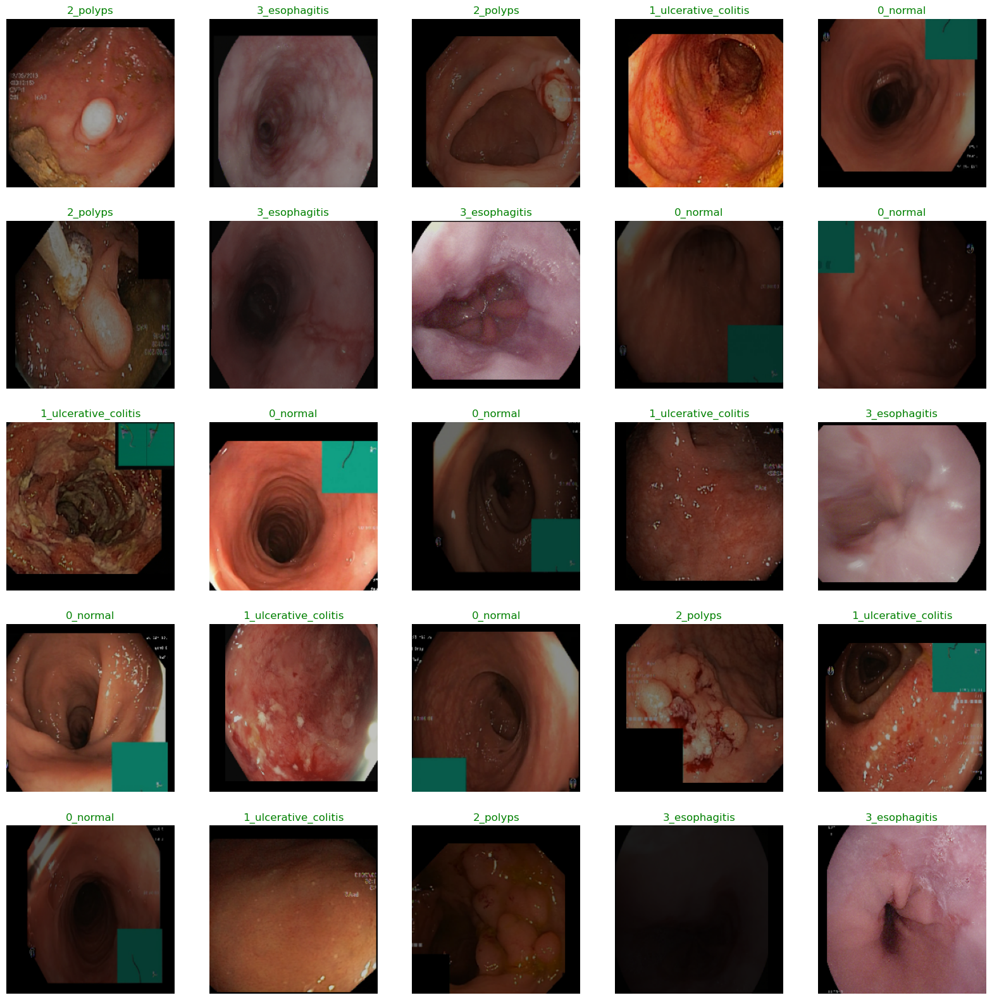

In [9]:
def show_image_samples(gen):
    """
    Displays a grid of image samples with their corresponding labels.

    Args:
        gen: ImageDataGenerator instance.

    Returns:
        None (displays the image samples).

    """
    # Get the class indices and names from the generator
    class_dict = gen.class_indices
    classes = list(class_dict.keys())

    # Get a sample batch of images and labels from the generator
    images, labels = next(gen)

    # Create a figure to display the image samples
    plt.figure(figsize=(20, 20))

    # Determine the number of images to display (maximum of 25)
    length = len(labels)
    if length < 25:
        r = length
    else:
        r = 25

    # Display each image sample with its corresponding label
    for i in range(r):
        plt.subplot(5, 5, i + 1)
        image = images[i]
        plt.imshow(image)
        index = np.argmax(labels[i])
        class_name = classes[index]
        plt.title(class_name, color='Green', fontsize=12)
        plt.axis('off')

    plt.show()

# Call the function to display image samples from the train_generator
show_image_samples(train_generator)


# Prepare Models

In [10]:
# Define the builder function for EfficientNetB0
def builder_a(model_input):
    """
    Builds the EfficientNetB0 model with partial layer freezing, layer compression, and an auxiliary fusing layer.

    Args:
        model_input: Input tensor for the model.

    Returns:
        The EfficientNetB0 model.

    """
    builder_a = trainable_model_a(weights='imagenet', include_top=False, input_tensor=model_input)

    # Partial layer freezing
    for layer in builder_a.layers:
        layer.trainable = False

    for layer in builder_a.layers:
        layer._name = layer.name + '_' + DCNN_A

    for BatchNormalization in builder_a.layers:
        BatchNormalization.trainable = False

    # Layer compression
    x = builder_a.layers[-17].output

    # Auxiliary fusing layer (AuxFL)
    x = Conv2D(192, 1, padding='valid', activation='selu', kernel_initializer='lecun_normal')(x)
    x = AveragePooling2D(1, 1)(x)
    x = AlphaDropout(0.2)(x)

    dcnn_a = Model(inputs=builder_a.input, outputs=x, name=DCNN_A)
    return dcnn_a

# Initialize the EfficientNetB0 model
dcnn_a = builder_a(model_input)

# Print the model summary
print("PLEASE CHECK THE ENTIRE MODEL UP TO THE END")
dcnn_a.summary()
print("successfully built!")


PLEASE CHECK THE ENTIRE MODEL UP TO THE END
Model: "DCNN_A"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1_DCNN_A (InputLayer)    [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_DCNN_A (Rescaling)   (None, 224, 224, 3)  0           ['input_1_DCNN_A[0][0]']         
                                                                                                  
 normalization_DCNN_A (Normaliz  (None, 224, 224, 3)  7          ['rescaling_DCNN_A[0][0]']       
 ation)                                                                                           
                                                 

In [13]:
# Define the builder function for MobileNetV2
def builder_b(model_input):
    """
    Builds the MobileNetV2 model with partial layer freezing, layer compression, and an auxiliary fusing layer.

    Args:
        model_input: Input tensor for the model.

    Returns:
        The MobileNetV2 model.

    """
    builder_b = trainable_model_b(weights='imagenet', include_top=False, input_tensor=model_input)

    # Partial layer freezing
    for layer in builder_b.layers:
        layer.trainable = False

    for layer in builder_b.layers:
        layer._name = layer.name + '_' + DCNN_B

    for BatchNormalization in builder_b.layers:
        BatchNormalization.trainable = False

    # Layer compression
    x = builder_b.layers[-39].output

    # Auxiliary fusing layer (AuxFL)
    x = Conv2D(192, 8, padding='valid', activation='selu', kernel_initializer='lecun_normal')(x)
    x = AveragePooling2D(1, 1)(x)
    x = AlphaDropout(0.2)(x)

    dcnn_b = Model(inputs=builder_b.input, outputs=x, name=DCNN_B)
    return dcnn_b

# Initialize the MobileNetV2 model
dcnn_b = builder_b(model_input)

# Print the model summary
print("PLEASE CHECK THE ENTIRE MODEL UP TO THE END")
dcnn_b.summary()
print("successfully built!")


PLEASE CHECK THE ENTIRE MODEL UP TO THE END
Model: "DCNN_B"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1_DCNN_A_DCNN_C_DCNN_A_D  [(None, 224, 224, 3  0          []                               
 CNN_B (InputLayer)             )]                                                                
                                                                                                  
 Conv1_DCNN_B (Conv2D)          (None, 112, 112, 32  864         ['input_1_DCNN_A_DCNN_C_DCNN_A_DC
                                )                                NN_B[0][0]']                     
                                                                                                  
 bn_Conv1_DCNN_B (BatchNormaliz  (None, 112, 112, 32  128        ['Conv1_DCNN_B[0][0]']           
 ation)                         )                

In [11]:
# Define the builder function for ResNet50V2
def builder_c(model_input):
    """
    Builds the ResNet50V2 model with partial layer freezing, layer compression, and an auxiliary fusing layer.

    Args:
        model_input: Input tensor for the model.

    Returns:
        The ResNet50V2 model.

    """
    builder_c = trainable_model_c(weights='imagenet', include_top=False, input_tensor=model_input)

    # Partial layer freezing
    for layer in builder_c.layers:
        layer.trainable = False

    for layer in builder_c.layers:
        layer._name = layer.name + '_' + DCNN_C

    for BatchNormalization in builder_c.layers:
        BatchNormalization.trainable = False

    # Layer compression
    x = builder_c.layers[-117].output

    # Auxiliary fusing layer (AuxFL)
    x = Conv2D(192, 6, padding='valid', activation='selu', kernel_initializer='lecun_normal')(x)
    x = AveragePooling2D(3, 3)(x)
    x = AlphaDropout(0.2)(x)

    dcnn_c = Model(inputs=builder_c.input, outputs=x, name=DCNN_C)
    return dcnn_c

# Initialize the ResNet50V2 model
dcnn_c = builder_c(model_input)

# Print the model summary
print("PLEASE CHECK THE ENTIRE MODEL UP TO THE END")
dcnn_c.summary()
print("successfully built!")


PLEASE CHECK THE ENTIRE MODEL UP TO THE END
Model: "DCNN_C"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1_DCNN_A_DCNN_C (InputLa  [(None, 224, 224, 3  0          []                               
 yer)                           )]                                                                
                                                                                                  
 conv1_pad_DCNN_C (ZeroPadding2  (None, 230, 230, 3)  0          ['input_1_DCNN_A_DCNN_C[0][0]']  
 D)                                                                                               
                                                                                                  
 conv1_conv_DCNN_C (Conv2D)     (None, 112, 112, 64  9472        ['conv1_pad_DCNN_C[0][0]']       
                                )                

# Prepare Fusion

In [14]:
#RE-INITIALIZE FOR FUSION
dcnn_a = builder_a(model_input)
dcnn_b = builder_b(model_input)
dcnn_c = builder_c(model_input)

print("Accomplished Pre-training and ready for fusion")

Accomplished Pre-training and ready for fusion


In [15]:
#FUSE THE MODELS INTO A SINGLE PIPELINE
models = [dcnn_a, 
          dcnn_b,
          dcnn_c]

print("Fusion success!")
print("Ready to connect with its ending layers!")

Fusion success!
Ready to connect with its ending layers!


In [16]:
# Build the Fusion Residual Block (FuRB) fusion model

def mfurecnn_builder(models, model_input):
    """
    Build the Fusion Residual Block (FuRB) fusion model.
    
    Args:
        models (list): List of models to be fused.
        model_input (tensorflow.keras.layers.Input): Input layer of the model.
        
    Returns:
        tensorflow.keras.models.Model: Fusion model.
    """
    
    outputs = [m.output for m in models]
    
    # Initial Fusion Layer
    y = Add(name='InitialFusionLayer')(outputs)
    
    # FuRB Layer
    y_bn1 = BatchNormalization()(y)
    y_selu1 = tf.keras.activations.selu(y_bn1)
    y_conv1 = Conv2D(192, 1, kernel_initializer='lecun_normal')(y_selu1)
    y_bn2 = BatchNormalization()(y_conv1)
    y_selu2 = tf.keras.activations.selu(y_bn2)
    y_conv2 = Conv2D(192, 1, kernel_initializer='lecun_normal')(y_selu2)
    
    y_merge = Add(name='FuRB')([y, y_conv2])
    
    # Fine-Tuning Layer
    y = GlobalAveragePooling2D()(y_merge)
    y = AlphaDropout(0.5)(y)
    prediction = Dense(num_classes, activation='softmax', name='Softmax_Classifier' + architecture)(y)
    model = Model(model_input, prediction, name=architecture)
    
    return model

# Instantiate the model and report the summary
mfurecnn = mfurecnn_builder(models, model_input)
mfurecnn._name = "MFuReCNN"
model_name = mfurecnn._name

print()
print()
print("PLEASE CHECK THE MODEL UP TO THE END")
print()
print()
print()

mfurecnn.summary()
model = mfurecnn
print("The", model_name, "is now complete and ready for compilation and training!")




PLEASE CHECK THE MODEL UP TO THE END



Model: "MFuReCNN"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1_DCNN_A_DCNN_C_DCNN_A_D  [(None, 224, 224, 3  0          []                               
 CNN_B_DCNN_A_DCNN_B_DCNN_C (In  )]                                                               
 putLayer)                                                                                        
                                                                                                  
 rescaling_4_DCNN_A (Rescaling)  (None, 224, 224, 3)  0          ['input_1_DCNN_A_DCNN_C_DCNN_A_DC
                                                                 NN_B_DCNN_A_DCNN_B_DCNN_C[0][0]']
                                                                                                  
 normalization_2_DCNN_A (Normal  (None, 224, 224,

In [17]:
# Import the necessary modules
from keras import models

# Extract the outputs of the top 8 layers of the model
# This will allow us to access the intermediate layer activations
layer_outputs = [layer.output for layer in model.layers[1:]]

# Create a new model that takes the same input as the original model
# and outputs the activations of the specified layers
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)


In [20]:
img_path = "C:\\Users\\Sai Tanvi\\Downloads\\archive\\val\\0_normal\\val_normal_ (99).jpg"

# We preprocess the image into a 4D tensor
from keras.preprocessing import image
import keras.utils as image
import numpy as np

# Load the image from the specified path and resize it to the target size
img = image.load_img(img_path, target_size=(224, 224))

# Convert the image to a numpy array
img_tensor = image.img_to_array(img)

# Add an extra dimension to the tensor to match the model's input shape
img_tensor = np.expand_dims(img_tensor, axis=0)

# Normalize the image by dividing by 255 (to scale the pixel values between 0 and 1)
img_tensor /= 255.

# Print the shape of the image tensor
# The shape should be (1, 224, 224, 3) since we have a single image with 3 color channels (RGB)
print(img_tensor.shape)


(1, 224, 224, 3)


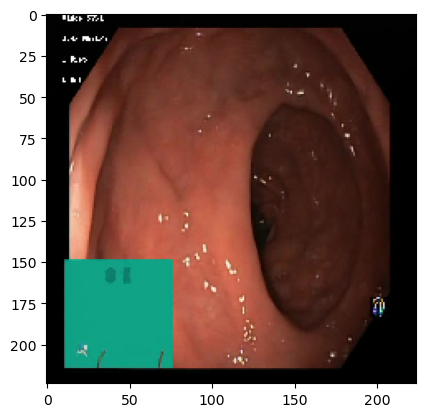

In [21]:
import matplotlib.pyplot as plt

# Display the preprocessed image
plt.imshow(img_tensor[0])
plt.show()


In [22]:
from keras import models

# Extracts the outputs of the top 8 layers:
layer_outputs = [layer.output for layer in model.layers[1:]]

# Creates a model that will return these outputs, given the model input:
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)


In [23]:
# This will return a list of 5 Numpy arrays: one array per layer activation
activations = activation_model.predict(img_tensor)


1/1 [==============================] - 2s 2s/step


In [24]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 224, 224, 3)


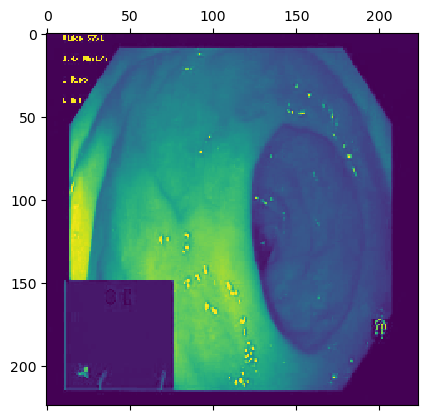

In [29]:
import matplotlib.pyplot as plt

plt.matshow(first_layer_activation[0, :, :, 0], cmap='viridis')
plt.show()

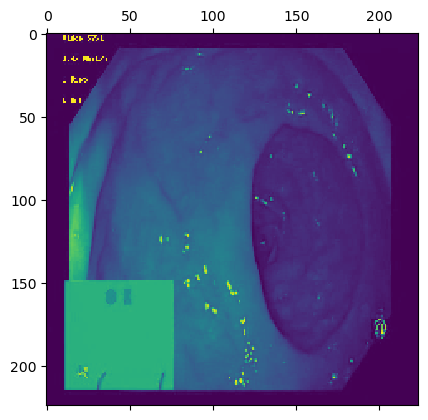

In [30]:
plt.matshow(first_layer_activation[0, :, :, 1], cmap='viridis')
plt.show()

C:\Users\Sai Tanvi\AppData\Local\Temp\ipykernel_14276\3414411794.py:42: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
C:\Users\Sai Tanvi\AppData\Local\Temp\ipykernel_14276\3414411794.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(scale * display_grid.shape[1],


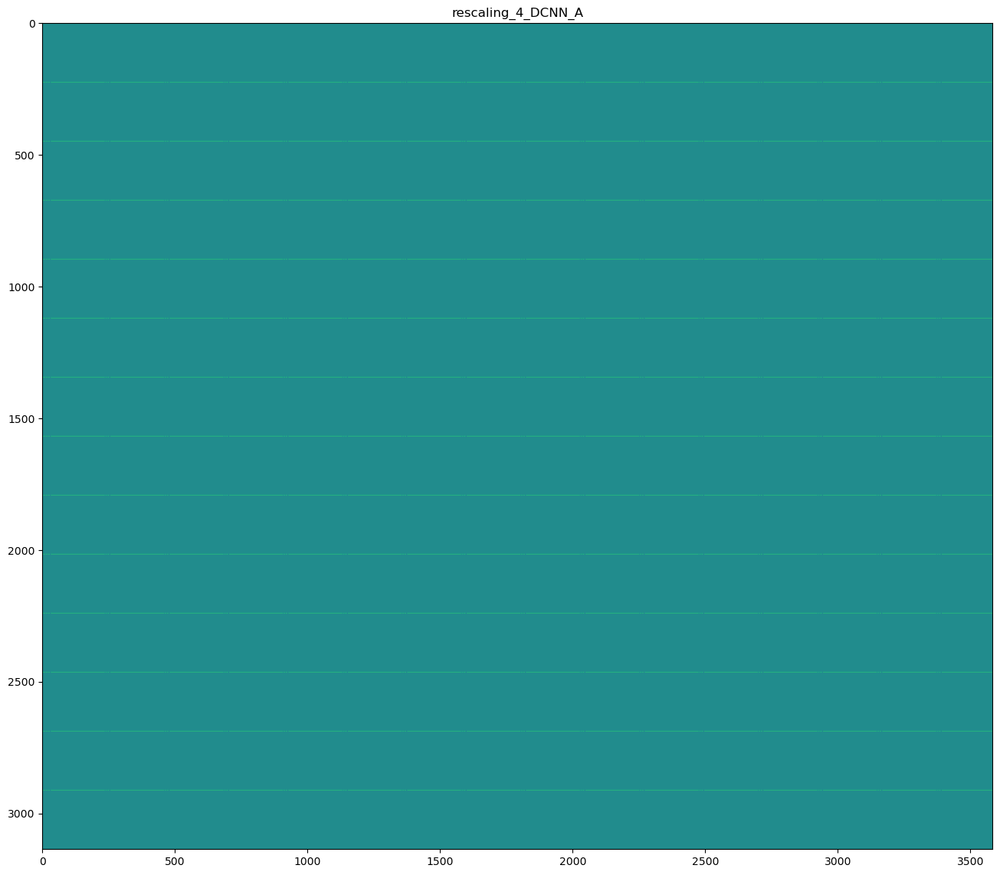

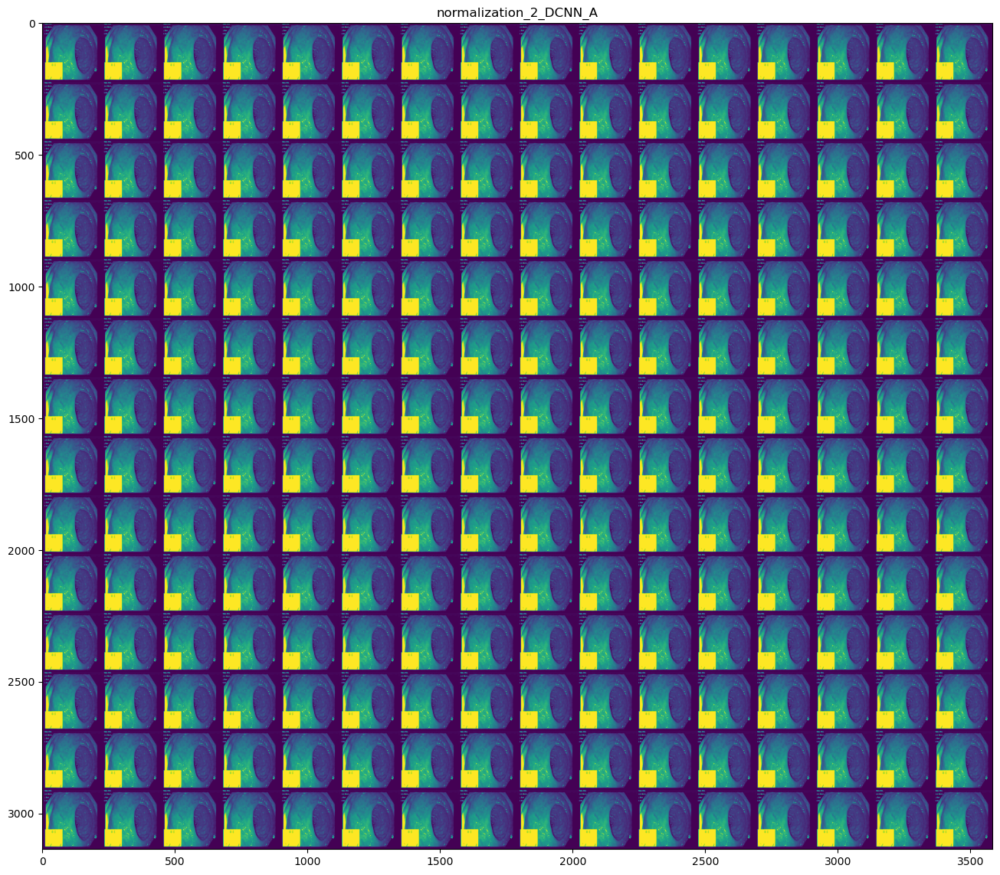

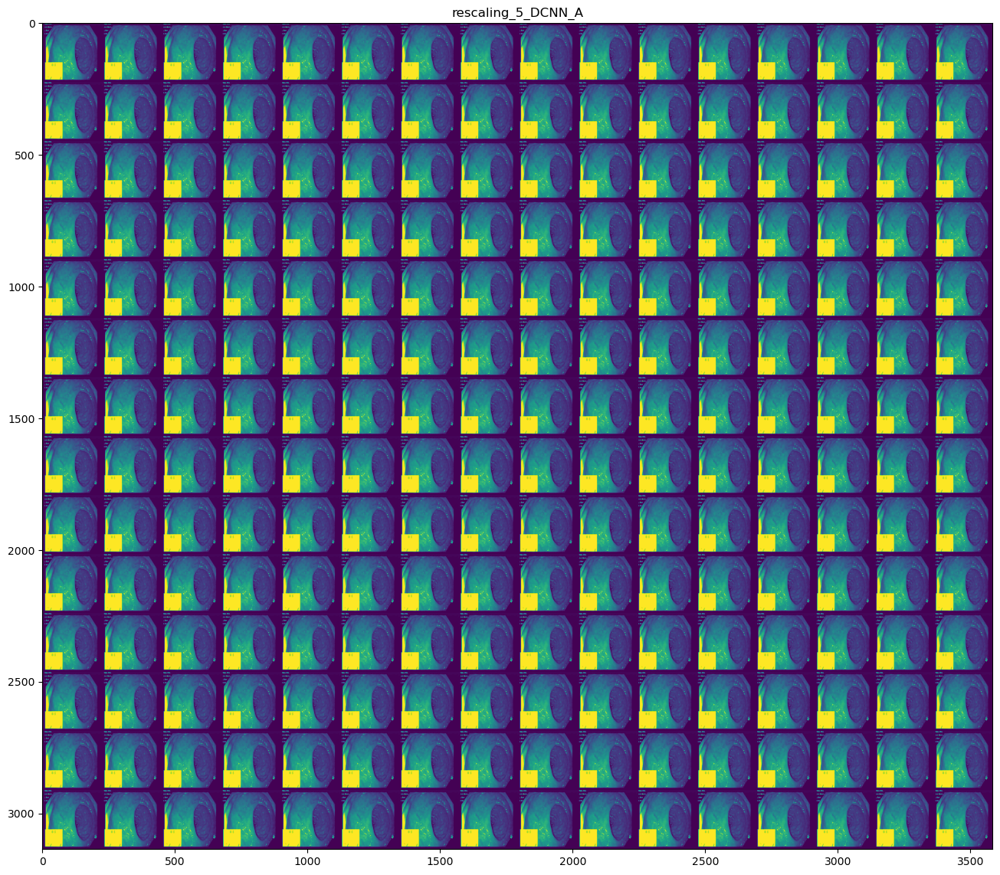

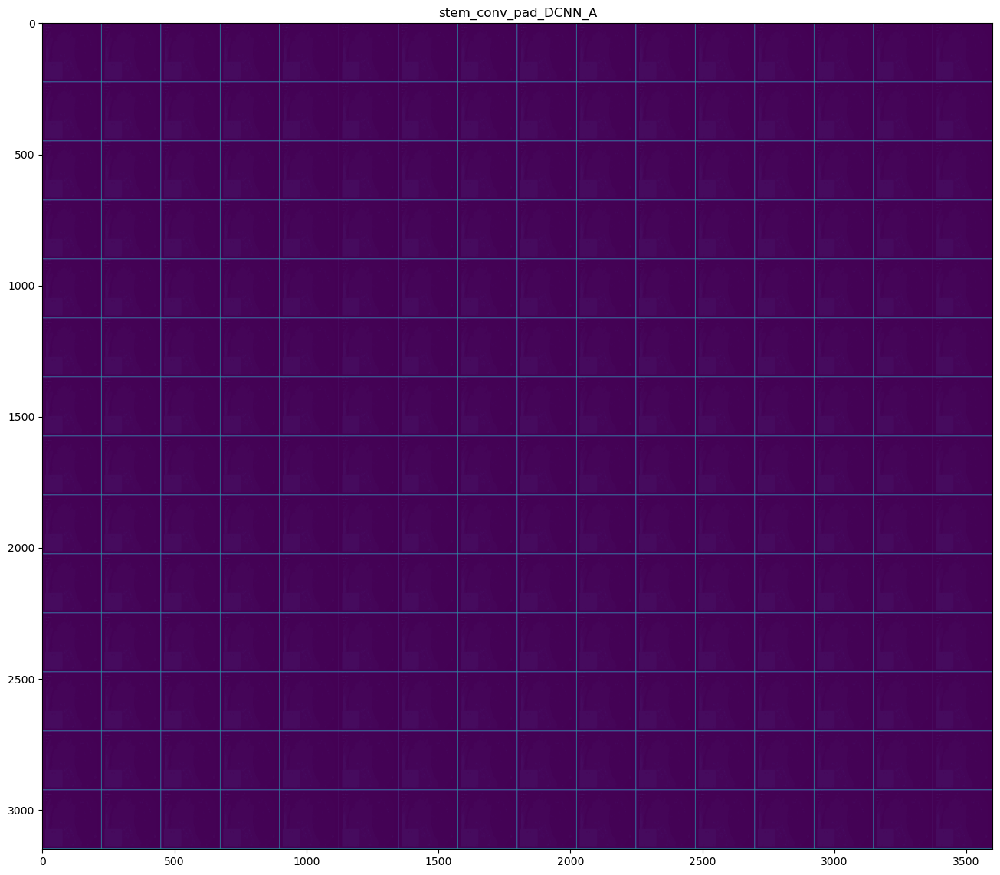

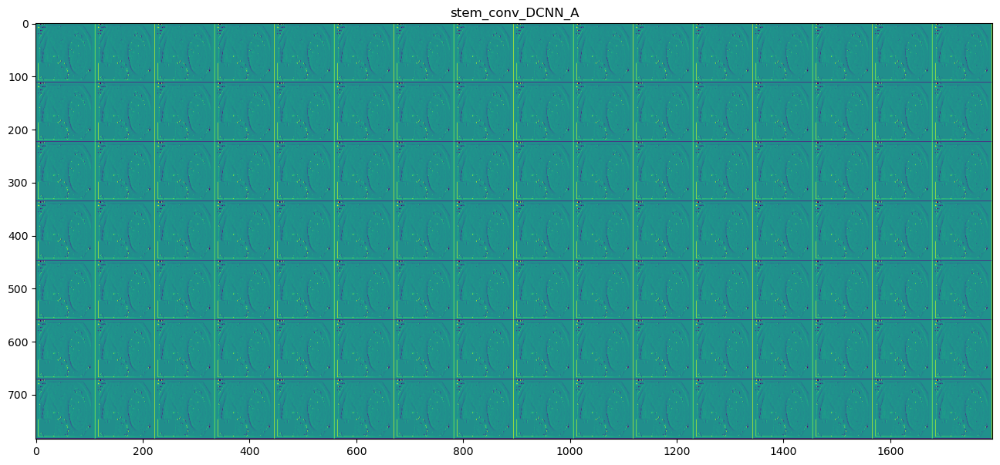

...

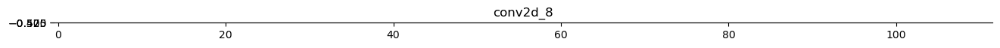

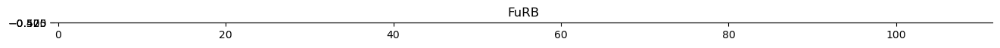

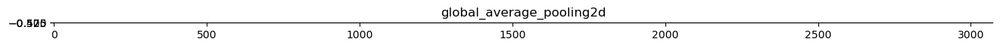

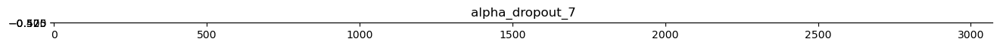

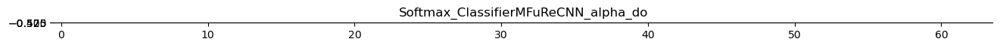

In [51]:
import keras
import numpy as np
import matplotlib.pyplot as plt

# These are the names of the layers, so we can have them as part of our plot
layer_names = []
for layer in model.layers[1:]:
    layer_names.append(layer.name)

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, col * images_per_row + row]
            
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    #plt.savefig(layer_name)
    
plt.show()


In [16]:
#Check the layer, the final layer should be FuRB!
last_conv_layer_name = mfurecnn.layers[-4].name

if last_conv_layer_name == 'FuRB':
    print("CORRECT LAYER SELECTED:", last_conv_layer_name)
else:
    print("INCORRECT LAYER SELECTED:", last_conv_layer_name)
    print("Please Reselect")

CORRECT LAYER SELECTED: FuRB


# Save the point

In [17]:
model_dir = 'model/'

# Check if the model directory exists, create it if it doesn't
if not os.path.exists(model_dir):
    os.mkdir(model_dir)
    print('Model directory', model_dir, 'successfully created')
else:
    print('Model directory already exists, no new directory made.')

print()
print('-'*50)
print('Model directory is available for saving the', model_name, 'model!')
print('-'*50)


Model directory already exist, no new directory made.

--------------------------------------------------
Model directory is available for saving the MFuReCNN model!
--------------------------------------------------


# Compile Model

In [18]:
mfurecnn.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Define a ReduceLROnPlateau callback
reduce_lr = ReduceLROnPlateau(monitor='val_acc', factor=0.5, patience=2, verbose=1, mode='max')

# Create a list of callbacks
callbacks = [reduce_lr]

print('-'*50)
print('Successfully compiled the', model_name, 'model!')
print('You may now proceed in training the', model_name, 'model!')
print('-'*50)


--------------------------------------------------
Successfully compiled the MFuReCNN model!
You may now proceed in training the MFuReCNN model!
--------------------------------------------------


# Train the Multi-Fused Residual CNN Model (MFuRe-CNN)

In [19]:
# Set training time
start_time = time.time()
print('*'*50)
print("Training", model_name)
print('*'*50)
print('-'*50)
print("Training time is being measured")
print('-'*50)

# Fit the model to the training data
history = mfurecnn.fit(train_generator, steps_per_epoch=nb_train_samples // batch_size,
                       epochs=epochs, validation_data=validation_generator,
                       callbacks=callbacks, 
                       validation_steps=nb_validation_samples // batch_size, verbose=1)

print()
print("MODEL SERIALIZING WAIT FOR A MOMENT...")
elapsed_time = time.time() - start_time
train_time = time.strftime("%H:%M:%S", time.gmtime(elapsed_time))
print()
print()
print(train_time, 'train_time')
print()
print(elapsed_time, 'Seconds')
print()
print()
print("MODEL SERIALIZATION DONE!")


**************************************************
Training MFuReCNN
**************************************************
--------------------------------------------------
Training time is being measured
--------------------------------------------------
Epoch 1/5
128/128 [==============================] - 716s 6s/step - loss: 1.3974 - accuracy: 0.4797 - val_loss: 0.3702 - val_accuracy: 0.8705 - lr: 1.0000e-05
Epoch 2/5
128/128 [==============================] - 825s 6s/step - loss: 0.6810 - accuracy: 0.7300 - val_loss: 0.2914 - val_accuracy: 0.9105 - lr: 1.0000e-05
Epoch 3/5
128/128 [==============================] - 786s 6s/step - loss: 0.5264 - accuracy: 0.7969 - val_loss: 0.2322 - val_accuracy: 0.9315 - lr: 1.0000e-05
Epoch 4/5
128/128 [==============================] - 770s 6s/step - loss: 0.4248 - accuracy: 0.8456 - val_loss: 0.2595 - val_accuracy: 0.9240 - lr: 1.0000e-05
Epoch 5/5
128/128 [==============================] - 771s 6s/step - loss: 0.3493 - accuracy: 0.8725 - val_loss

# Save the Trained Model

In [22]:
import tensorflow as tf
print(tf.__version__)

#!pip install --upgrade tensorflow==2.9.1

# SAVE THE HISTORY FOR EVALUATION
save_h('model/', history.history)

# SAVE AFTER TRAINING COMPLETES
mfurecnn.save('model/' + architecture + '/' + architecture + '.h5')

# Prompt
print("-"*50)
print()
print("The Model weights and history of the", model_name, "successfully trained and saved!")
print()
print("-"*50)


2.12.0
history saved


TypeError: Unable to serialize [2.0896919 2.1128857 2.1081853] to JSON. Unrecognized type <class 'tensorflow.python.framework.ops.EagerTensor'>.

In [23]:
#Re-load the trained model
model = load_model('model/' + architecture + '/' + architecture + '.h5')
print("The", model_name,  "is successfully loaded!")

ValueError: No model config found in the file at <tensorflow.python.platform.gfile.GFile object at 0x000001C702A71160>.

# Evalution with validation DATASET

In [24]:
# Evaluate validation accuracy
y_pred = model.predict(validation_generator, nb_validation_samples/batch_size, workers=1)
accuracy = accuracy_score(Y_test, y_pred.argmax(axis=-1))
print('The val accuracy of the', model._name, 'is:', accuracy)

# Evaluate mean squared error
mse = mean_squared_error(Y_test, y_pred.argmax(axis=-1))
print('The val MSE of the', model._name, 'is:', mse)

# Evaluate mean squared log error
msle = mean_squared_log_error(Y_test, y_pred.argmax(axis=-1))
print('The val MSLE of the', model._name, 'is:', msle)


NameError: name 'model' is not defined

In [ ]:
#Figure
dpi = 1000  # Resolution of the figure in dots per inch
figsize = (12, 12)  # Size of the figure in inches

#Markers
marker_train_accuracy = 's'  # Marker style for training accuracy
marker_validation_accuracy = 'x'  # Marker style for validation accuracy
marker_train_loss = 'o'  # Marker style for training loss
marker_validation_loss = '|'  # Marker style for validation loss
marker_fillstyle_train = 'none'  # Fill style for training markers
marker_fillstyle_validation = 'none'  # Fill style for validation markers
marker_plot_markersize = 25  # Size of markers in the plot
marker_plot_markerwidth = 3  # Width of markers' edges

#Lines
line_style_train = '-'  # Line style for training curve
line_style_validation = '--'  # Line style for validation curve
line_width_train = '5'  # Width of training curve line
line_width_val = line_width_train  # Width of validation curve line
line_color_train_accuracy = 'black'  # Color of training accuracy curve
line_color_val_accuracy = 'black'  # Color of validation accuracy curve
line_color_train_loss = 'black'  # Color of training loss curve
line_color_val_loss = 'black'  # Color of validation loss curve

#Labels
train_accuracy_label = 'Train ' + 'Acc'  # Label for training accuracy curve
validation_accuracy_label = 'Val ' + 'Acc'  # Label for validation accuracy curve
train_loss_label = 'Train ' + 'Loss'  # Label for training loss curve
validation_loss_label = 'Val ' 'Loss'  # Label for validation loss curve
x_label_font_size = 56  # Font size for x-axis label
y_label_font_size = x_label_font_size  # Font size for y-axis label
x_label_font = 'Tahoma'  # Font family for x-axis label
y_label_font = x_label_font  # Font family for y-axis label

#Ticks
spine_axis_thickness = 4  # Thickness of axis spine
tick_font_size = 42  # Font size for tick labels
tick_length = 12  # Length of ticks in points
tick_width = spine_axis_thickness  # Width of ticks in points

#Legend
legend_border_pad = 0.35  # Padding between legend content and border
legend_line_width = 5  # Width of legend frame outline
legend_font_size = 50  # Font size for legend labels
legend_edge_color = 'black'  # Color of legend frame outline
legend_label_spacing = 0.5  # Spacing between legend labels
legend_location = 'best'  # Location of the legend
legend_ncol = 1  # Number of columns in the legend
legend_font = 'Tahoma'  # Font family for legend labels
legend_has_frame = True  # Boolean indicating whether the legend has a frame


<Figure size 12000x12000 with 0 Axes>

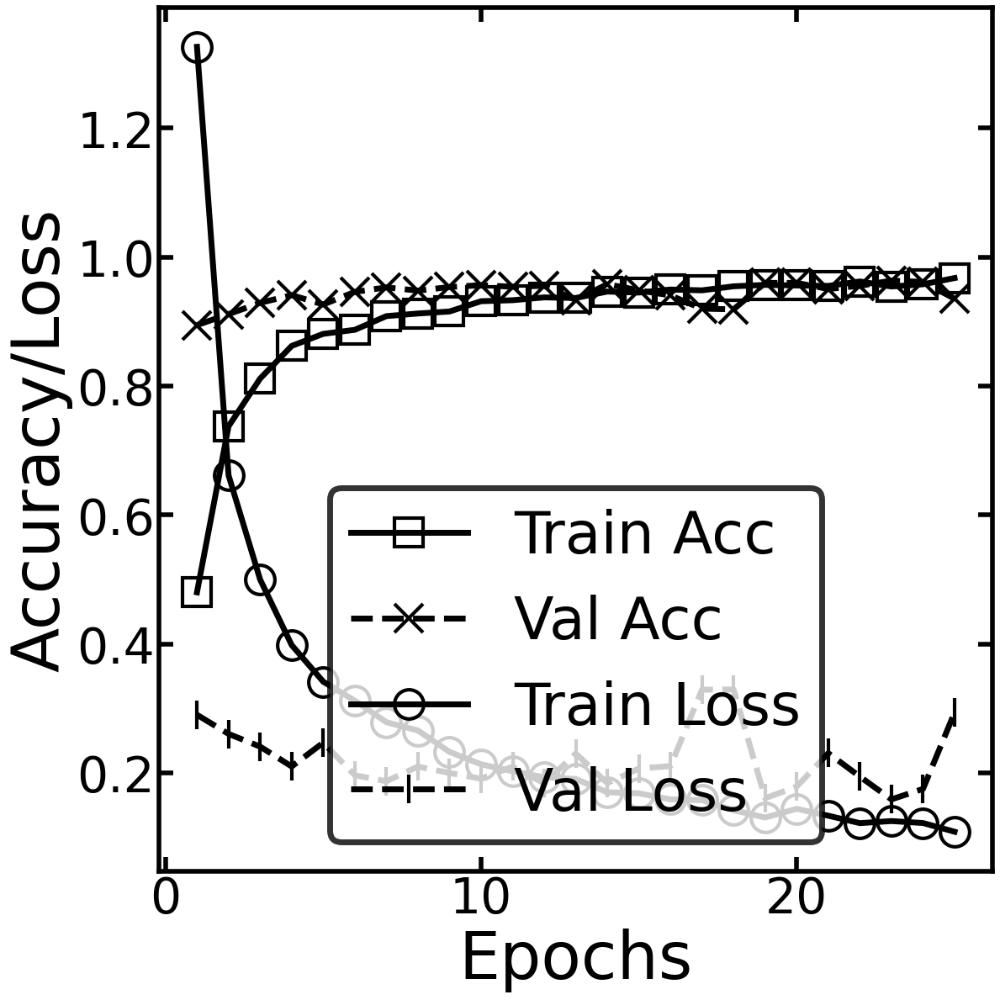

In [ ]:
plt.style.use("default")  # Set the default plot style
plt.figure(figsize=figsize, dpi=dpi, edgecolor='black', facecolor='white', linewidth=0)  # Create a new figure with specified size and resolution
plt.tight_layout()  # Adjust the layout of the plot to prevent overlapping elements
plt.rc('xtick', labelsize=tick_font_size, direction="in")  # Set the font size and direction of x-axis tick labels
plt.rc('ytick', labelsize=tick_font_size, direction="in")  # Set the font size and direction of y-axis tick labels

fig, ax = plt.subplots(figsize=figsize)  # Create subplots with specified size
plt.gcf().subplots_adjust(bottom=0.15)  # Adjust the bottom position of the subplots to make room for labels
plt.setp(ax.spines.values(), linewidth=spine_axis_thickness)  # Set the linewidth of the axis spines

plt.tick_params(length=tick_length, width=tick_width, right=True, top=True)  # Set the length and width of ticks on the plot

# Plot the training accuracy curve
plt.plot(np.arange(1, epochs + 1), history.history["accuracy"], mew=marker_plot_markerwidth, color=line_color_train_accuracy,
         lw=line_width_train, marker=marker_train_accuracy, markersize=marker_plot_markersize,
         fillstyle=marker_fillstyle_train, ls=line_style_train, label=train_accuracy_label)

# Plot the validation accuracy curve
plt.plot(np.arange(1, epochs + 1), history.history["val_accuracy"], mew=marker_plot_markerwidth, color=line_color_val_accuracy,
         lw=line_width_val, marker=marker_validation_accuracy, markersize=marker_plot_markersize,
         fillstyle=marker_fillstyle_validation, ls=line_style_validation, label=validation_accuracy_label)

# Plot the training loss curve
plt.plot(np.arange(1, epochs + 1), history.history["loss"], mew=marker_plot_markerwidth, color=line_color_train_loss,
         lw=line_width_train, marker=marker_train_loss, markersize=marker_plot_markersize,
         fillstyle=marker_fillstyle_train, ls=line_style_train, label=train_loss_label)

# Plot the validation loss curve
plt.plot(np.arange(1, epochs + 1), history.history["val_loss"], mew=marker_plot_markerwidth, color=line_color_val_loss,
         lw=line_width_val, marker=marker_validation_loss, markersize=marker_plot_markersize,
         fillstyle=marker_fillstyle_validation, ls=line_style_validation, label=validation_loss_label)

plt.xlabel("Epochs", fontfamily=x_label_font, fontsize=x_label_font_size, color='black')  # Set the label and font properties for the x-axis
plt.ylabel("Accuracy/Loss", fontfamily=y_label_font, fontsize=y_label_font_size, color='black')  # Set the label and font properties for the y-axis

legend = plt.legend(loc=legend_location, ncol=legend_ncol, frameon=legend_has_frame, fontsize=legend_font_size,
                    edgecolor=legend_edge_color, borderpad=legend_border_pad, labelspacing=legend_label_spacing)  # Create the legend

frame = legend.get_frame()  # Get the frame of the legend
legend.get_frame().set_linewidth(legend_line_width)  # Set the linewidth of the legend frame
legend.get_frame().set_edgecolor(legend_edge_color)  # Set the edge color of the legend frame
plt.setp(legend.texts, family=legend_font)  # Set the font family for legend labels
plt.tight_layout()  # Adjust the layout of the plot to prevent overlapping elements


              precision    recall  f1-score   support

           0     0.9978    0.9040    0.9486       500
           1     0.7611    0.9940    0.8621       500
           2     0.9974    0.7760    0.8729       500
           3     0.9881    0.9980    0.9930       500

    accuracy                         0.9180      2000
   macro avg     0.9361    0.9180    0.9192      2000
weighted avg     0.9361    0.9180    0.9192      2000

Normalized confusion matrix
[[0.904 0.096 0.    0.   ]
 [0.    0.994 0.002 0.004]
 [0.002 0.214 0.776 0.008]
 [0.    0.002 0.    0.998]]


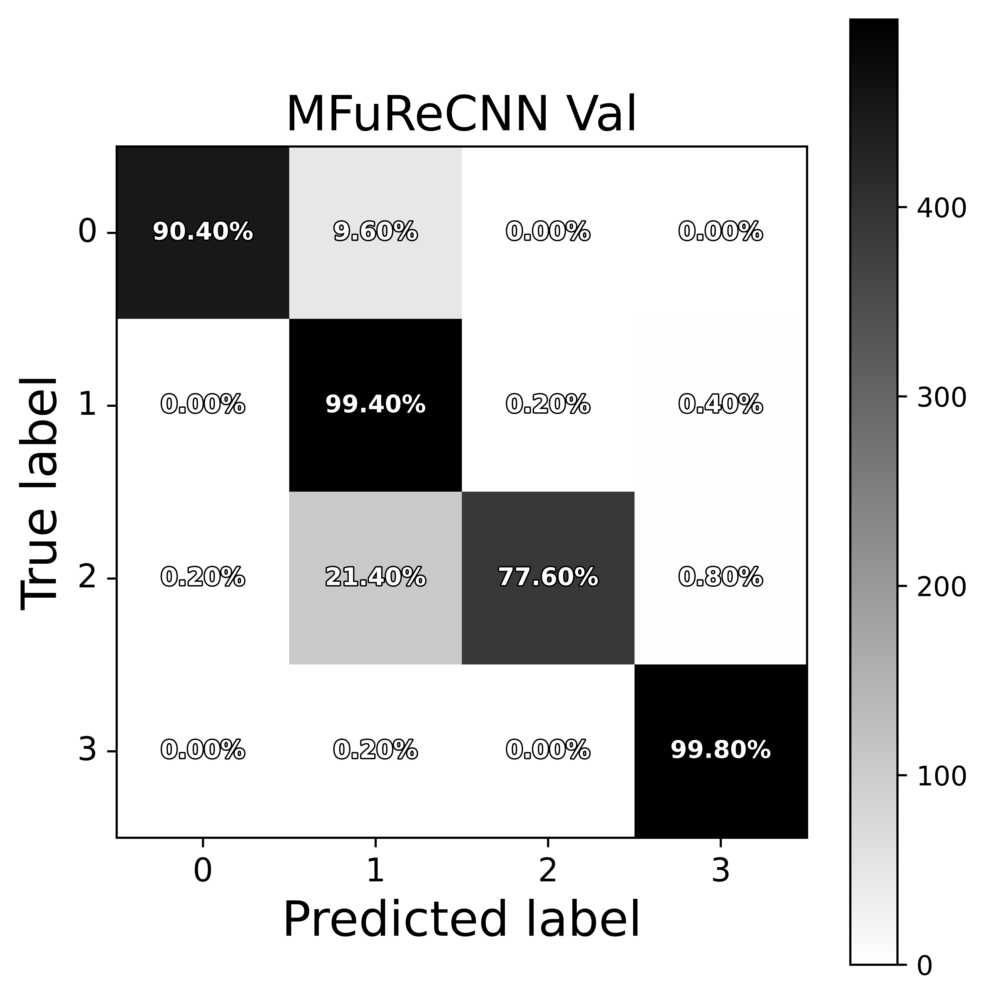

In [ ]:
fontsize = 12

def confusion_matrix_test(cm, classes, normalize=True, title=model._name + ' Val', cmap=plt.cm.binary):
    """
    Plot the confusion matrix.
    
    Args:
    - cm: Confusion matrix array
    - classes: List of class labels
    - normalize: Whether to normalize the confusion matrix
    - title: Title of the plot
    - cmap: Colormap to use for the plot
    """

    plt.imshow(cm, interpolation='nearest', cmap=cmap)  # Display the confusion matrix as an image
    plt.title(title, fontsize=18)  # Set the title of the plot
    plt.colorbar(orientation='vertical')  # Add a colorbar to the plot
    tick_marks = np.arange(len(classes))  # Create tick marks for the class labels
    plt.xticks(tick_marks, classes, rotation=0, fontfamily='Tahoma', fontsize=fontsize,
               horizontalalignment="center")  # Set the x-axis tick labels
    plt.yticks(tick_marks, classes, rotation=0, fontfamily='Tahoma', fontsize=fontsize,
               verticalalignment="center")  # Set the y-axis tick labels

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize the confusion matrix
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)  # Print the confusion matrix

    thresh = cm.max() / 2.  # Calculate the threshold for text color
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        text = plt.text(j, i, '{:.2f}%'.format(cm[i, j] * 100),  # Add text annotations to the plot
                        fontfamily='Tahoma', fontsize=9, weight='bold',
                        horizontalalignment="center", verticalalignment='center',
                        color="white" if cm[i, j] > thresh else "white")
        text.set_path_effects([path_effects.Stroke(linewidth=1, foreground='black'),
                               path_effects.Normal()])

    plt.tight_layout()  # Adjust the layout of the plot
    plt.ylabel('True label', fontfamily='Tahoma', fontsize=18, horizontalalignment="center")  # Set the y-axis label
    plt.xlabel('Predicted label', fontfamily='Tahoma', fontsize=18)  # Set the x-axis label


# Print classification report and plot confusion matrix
plt.style.use("default")  # Set the default plot style
target_names = ['0', '1', '2', '3']  # Define the names of the classes
print(classification_report(Y_test, y_pred.argmax(axis=-1), target_names=target_names, digits=4))  # Print the classification report

# Compute confusion matrix
cnf_matrix_test = confusion_matrix(Y_test, y_pred.argmax(axis=-1))  # Compute the confusion matrix
np.set_printoptions(precision=4)  # Set the precision for printing floating-point numbers

# Plot non-normalized confusion matrix
plt.figure(figsize=(5.25, 5.25), dpi=dpi)  # Create a new figure with specified size
confusion_matrix_test(cnf_matrix_test, classes=target_names)  # Plot the confusion matrix
plt.tight_layout()  # Adjust the layout of the plot

plt.show()  # Show the plot


In [ ]:
plt.rcParams.update({'figure.figsize': [6, 6]})  # Set the figure size
plt.rcParams.update({'figure.dpi': 300})  # Set the DPI for the figure
plt.rcParams.update({'font.size': 12})  # Set the font size
plt.rcParams.update({'legend.borderpad': 0.2})  # Set the border pad for the legend
plt.rcParams.update({'legend.fontsize': 'xx-large'})  # Set the font size for the legend
plt.rcParams.update({'legend.frameon': True})  # Set whether to display the legend frame


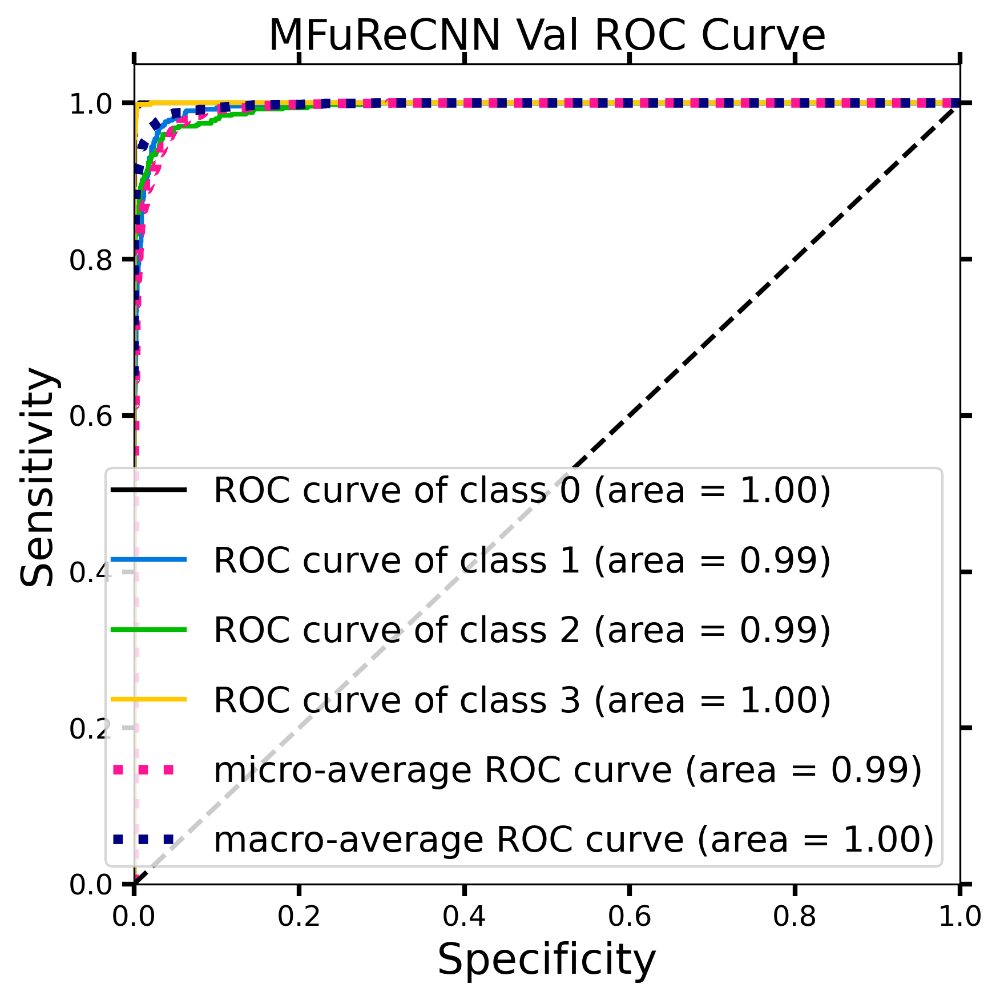

In [ ]:
import scikitplot as skplt

skplt.metrics.plot_roc(Y_test, y_pred)
plt.title(model._name + ' Val' + ' ROC Curve', fontsize=18, fontfamily='Tahoma')
plt.xlabel('Specificity', fontsize=18, fontfamily='Tahoma')
plt.ylabel('Sensitivity', fontsize=18, fontfamily='Tahoma')

plt.tick_params(length=5, width=2, right=True, top=True, labelsize=12)

plt.rc('xtick', direction="in") 
plt.rc('ytick', direction="in") 
legend = plt.legend(loc="lower right", fontsize=15, labelspacing=1)
plt.setp(legend.texts, family='Tahoma')

plt.tight_layout()
plt.show()


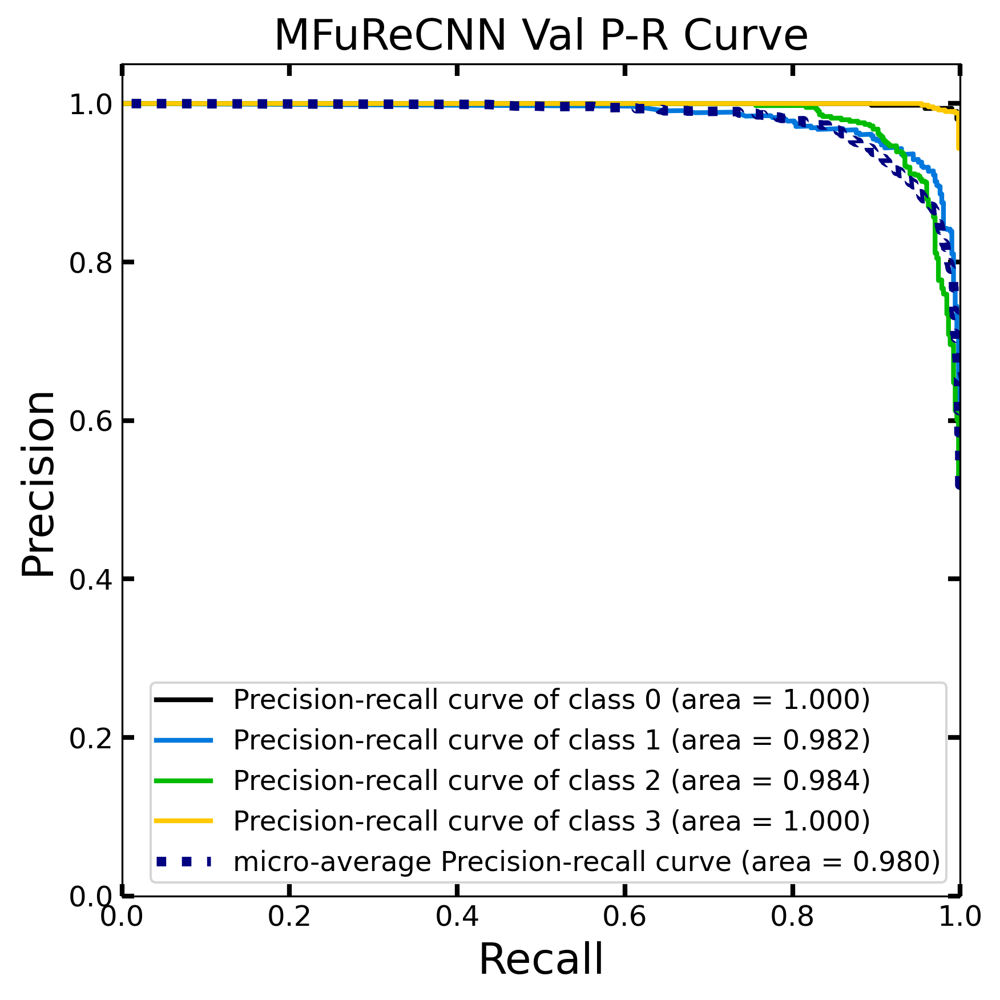

In [ ]:
import scikitplot as skplt

skplt.metrics.plot_precision_recall(Y_test, y_pred)
plt.title(model._name + ' Val' + ' P-R Curve', fontsize=18, fontfamily='Tahoma')
plt.xlabel('Recall', fontsize=18, fontfamily='Tahoma')
plt.ylabel('Precision', fontsize=18, fontfamily='Tahoma')

plt.tick_params(length=5, width=2, right=True, top=True, labelsize=12)

plt.rc('xtick', direction="in") 
plt.rc('ytick', direction="in") 
plt.legend(loc="lower right", fontsize=11.5, labelspacing=0.5)
plt.setp(legend.texts, family='Tahoma')

plt.tight_layout()
plt.show()


In [ ]:
#Sanity check for validation
model.evaluate(validation_generator, return_dict=True)

80/80 [==============================] - 29s 338ms/step - loss: 0.3680 - accuracy: 0.9180


{'loss': 0.3680334985256195, 'accuracy': 0.9179999828338623}

# Evaluation with test DATASET

In [ ]:
y_pred_test = model.predict(test_generator, nb_test_samples/batch_size, workers=1)

accuracy_test = accuracy_score(test_labels, y_pred_test.argmax(axis=-1))
print('The test accuracy of the ' + model._name + ' is: ', accuracy_test)

mse_test = mean_squared_error(test_labels, y_pred_test.argmax(axis=-1))
print('The test MSE of the ' + model._name + ' is: ', mse_test)

msle_test = mean_squared_log_error(test_labels, y_pred_test.argmax(axis=-1))  
print('The test MSLE of the ' + model._name +  ' is: ', msle_test)


The test accuracy of the MFuReCNN is:  0.93
The test MSE of the MFuReCNN is:  0.07375
The test MSLE of the MFuReCNN is:  0.01733204292413723


              precision    recall  f1-score   support

           0     1.0000    0.9300    0.9637       200
           1     0.7866    0.9950    0.8786       200
           2     1.0000    0.7950    0.8858       200
           3     0.9901    1.0000    0.9950       200

    accuracy                         0.9300       800
   macro avg     0.9442    0.9300    0.9308       800
weighted avg     0.9442    0.9300    0.9308       800

Normalized confusion matrix
[[0.93  0.07  0.    0.   ]
 [0.    0.995 0.    0.005]
 [0.    0.2   0.795 0.005]
 [0.    0.    0.    1.   ]]


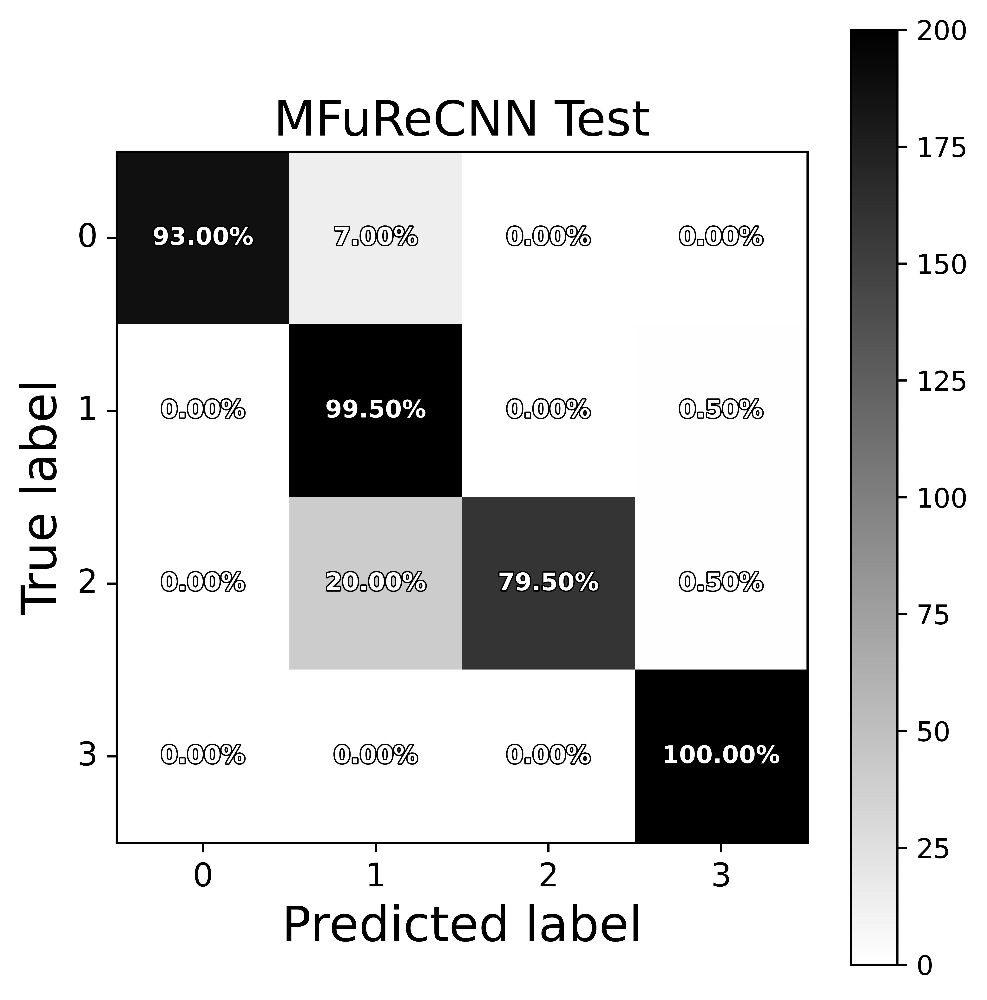

In [ ]:
fontsize=12

def confusion_matrix_test(cm, classes,
                          normalize=True,
                          title=model._name + ' Test',
                          cmap=plt.cm.binary):

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=18)
    plt.colorbar(orientation='vertical')
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=0, fontfamily='Tahoma', fontsize=fontsize, horizontalalignment="center")
    plt.yticks(tick_marks, classes, rotation=0, fontfamily='Tahoma', fontsize=fontsize, verticalalignment="center")

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        text = plt.text(j, i, '{:.2f}%'.format(cm[i, j]*100),
                 fontfamily='Tahoma',
                 fontsize=9, weight='bold',
                 horizontalalignment="center", verticalalignment='center',
                 color="white" if cm[i, j] > thresh else "white")
        text.set_path_effects([path_effects.Stroke(linewidth=1, foreground='black'),
                               path_effects.Normal()]),

    plt.tight_layout()
    plt.ylabel('True label', fontfamily='Tahoma', fontsize=18, horizontalalignment="center")
    plt.xlabel('Predicted label', fontfamily='Tahoma', fontsize=18)

# Print classification report and plot confusion matrix
plt.style.use("default")
target_names = ['0', '1', '2', '3']  # 0-Normal, 1-Ulcer, 2-Polyps, 3-Esophagitis
print(classification_report(test_labels, y_pred_test.argmax(axis=-1),
                            target_names=target_names, digits=4))

# Compute confusion matrix
cnf_matrix_test = confusion_matrix(test_labels, y_pred_test.argmax(axis=-1))
np.set_printoptions(precision=4)

# Plot non-normalized confusion matrix
plt.figure(figsize=(5.25, 5.25), dpi=dpi)
confusion_matrix_test(cnf_matrix_test, classes=target_names)
plt.tight_layout()

plt.show()


In [ ]:
plt.rcParams.update({'figure.figsize': [6,6]})
plt.rcParams.update({'figure.dpi': 300})
plt.rcParams.update({'font.size': 12})
plt.rcParams.update({'legend.borderpad': 0.2})
plt.rcParams.update({'legend.fontsize': 'xx-large'})
plt.rcParams.update({'legend.frameon': True})


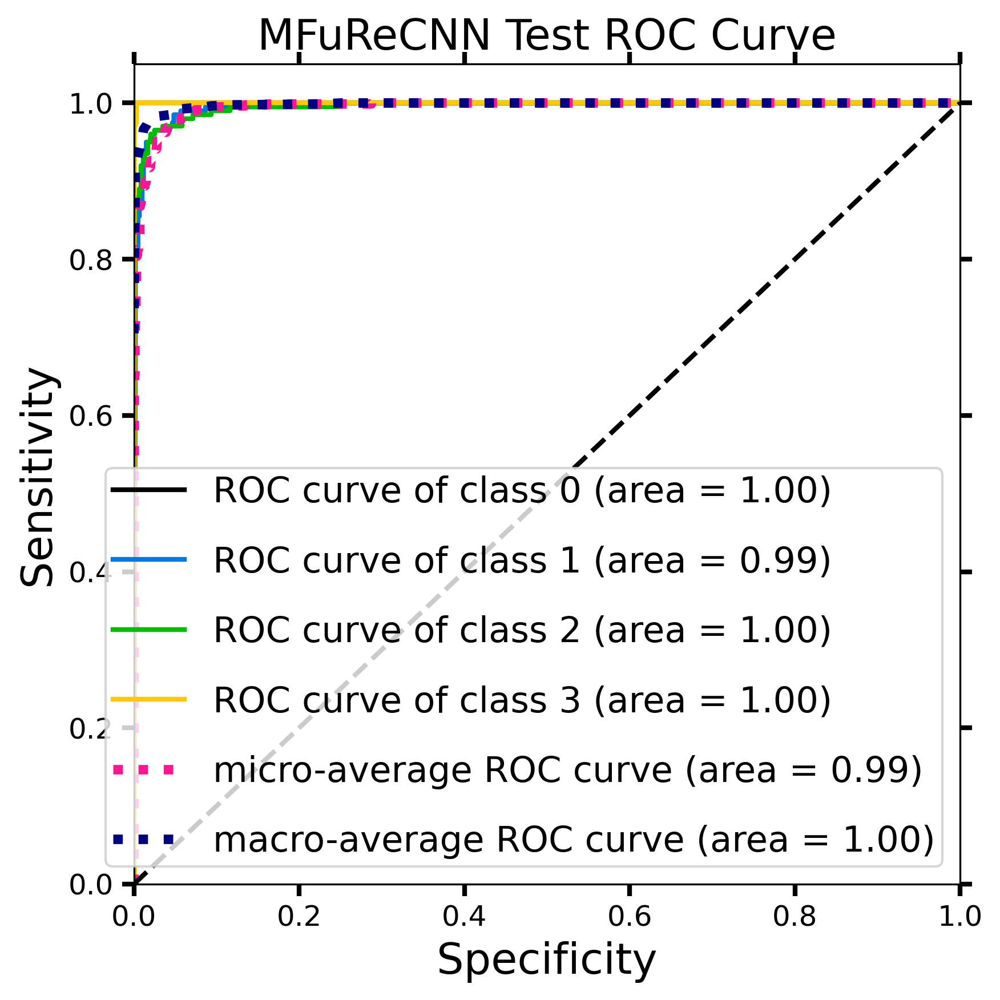

In [ ]:
# Plot ROC curve for test data
scikitplot.metrics.plot_roc(test_labels, y_pred_test)

# Set the title of the plot
plt.title(model._name + ' Test' + ' ROC Curve', fontsize=18, fontfamily='Tahoma')

# Set the x and y axis labels
plt.xlabel('Specificity', fontsize=18, fontfamily='Tahoma')
plt.ylabel('Sensitivity', fontsize=18, fontfamily='Tahoma')

# Set tick parameters
plt.tick_params(length=5, width=2, right=True, top=True, labelsize=12)

# Set the direction of ticks
plt.rc('xtick', direction="in") 
plt.rc('ytick', direction="in") 

# Add a legend to the plot
legend = plt.legend(loc="lower right", fontsize=15, labelspacing=1)
plt.setp(legend.texts, family='Tahoma')

# Adjust the layout of the plot
plt.tight_layout()

# Display the plot
plt.show()


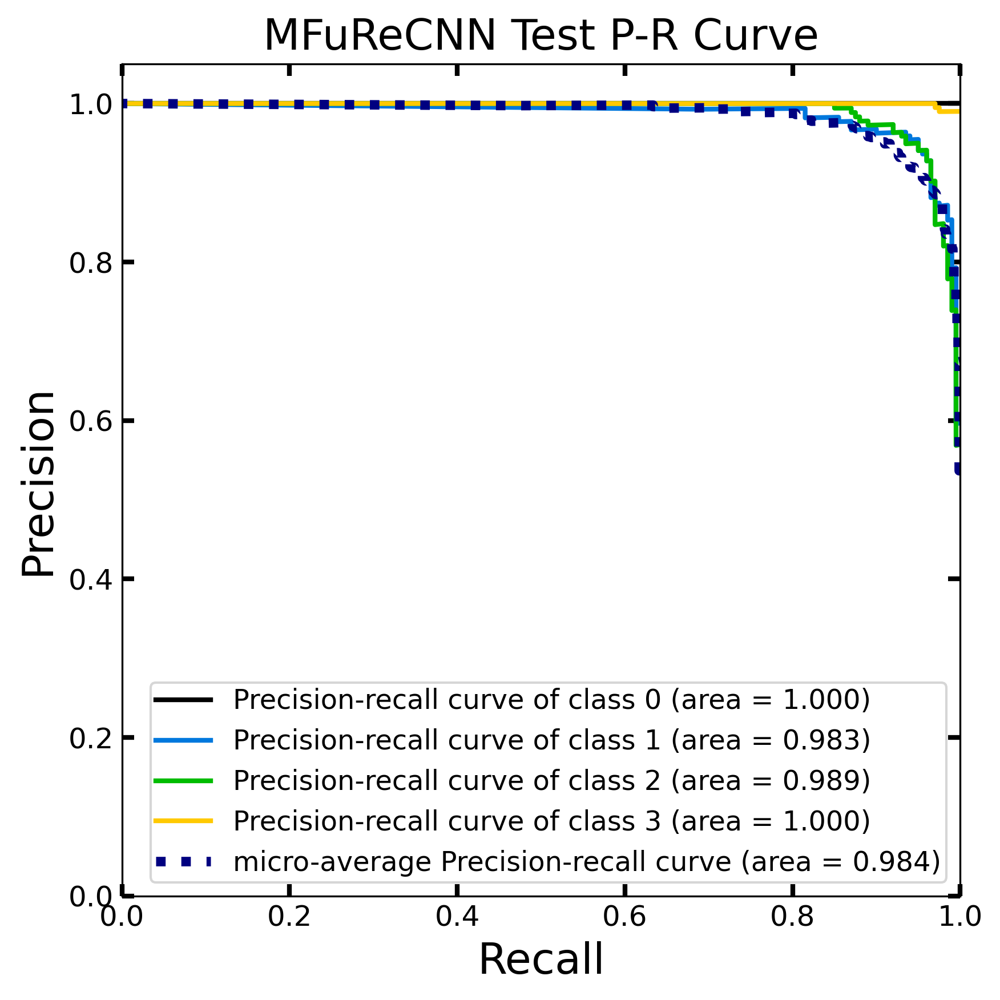

In [ ]:
# Plot precision-recall curve for test data
scikitplot.metrics.plot_precision_recall(test_labels, y_pred_test)

# Set the title of the plot
plt.title(model._name + ' Test' + ' P-R Curve', fontsize=18, fontfamily='Tahoma')

# Set the x and y axis labels
plt.xlabel('Recall', fontsize=18, fontfamily='Tahoma')
plt.ylabel('Precision', fontsize=18, fontfamily='Tahoma')

# Set tick parameters
plt.tick_params(length=5, width=2, right=True, top=True, labelsize=12)

# Set the direction of ticks
plt.rc('xtick', direction="in") 
plt.rc('ytick', direction="in") 

# Add a legend to the plot
plt.legend(loc="lower right", fontsize=11.5, labelspacing=0.5)
plt.setp(legend.texts, family='Tahoma')

# Adjust the layout of the plot
plt.tight_layout()

# Display the plot
plt.show()


In [ ]:
#Sanity check for test
model.evaluate(test_generator, return_dict=True)

32/32 [==============================] - 11s 358ms/step - loss: 0.2945 - accuracy: 0.9300


{'loss': 0.2945404350757599, 'accuracy': 0.9300000071525574}

In [ ]:
def cost_compute():
    """
    Calculate and print the FLOPS, total parameters, and trainable parameters of a model.
    """
    # Calculate FLOPS (floating-point operations per second)
    flops = float("{0:.2f}".format(get_flops(Model(model.input, model.output), batch_size=1) / 10 ** 9))

    # Calculate total parameters
    params = float("{0:.2f}".format(model.count_params() / 10 ** 6))

    # Calculate trainable parameters
    trainable_count = float("{0:.2f}".format(count_params(model.trainable_weights) / 10 ** 6))

    # Print the computed values
    print("FLOPS:", flops, "GFLOPS")
    print("Params:", params, "M")
    print("Trainable Params:", trainable_count, "M")

# Call the function to compute and print the cost efficiency metrics
cost_compute()



=========================Options=============================
-max_depth                  10000
-min_bytes                  0
-min_peak_bytes             0
-min_residual_bytes         0
-min_output_bytes           0
-min_micros                 0
-min_accelerator_micros     0
-min_cpu_micros             0
-min_params                 0
-min_float_ops              1
-min_occurrence             0
-step                       -1
-order_by                   float_ops
-account_type_regexes       .*
-start_name_regexes         .*
-trim_name_regexes          
-show_name_regexes          .*
-hide_name_regexes          
-account_displayed_op_only  true
-select                     float_ops
-output                     stdout:

==================Model Analysis Report======================

Doc:
scope: The nodes in the model graph are organized by their names, which is hierarchical like filesystem.
flops: Number of float operations. Note: Please read the implementation for the math behind it.

Profi